# Importing required libraries

In [1]:
!pip install torch_snippets torch_summary --quiet
import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary

[03/04/24 20:08:09] WARNING  Skipping cv2 import                                                                                                      ]8;id=615660;file:///opt/conda/lib/python3.10/site-packages/torch_snippets/loader.py:146\loader.py]8;;\:]8;id=204010;file:///opt/conda/lib/python3.10/site-packages/torch_snippets/loader.py:146#<module>:146\<module>:146]8;;\

In [ ]:
# prompt: mount drive

from google.colab import drive
drive.mount('/content/drive')


### Looking at what the shape of our training images are

In [2]:
img = Image.open('testA/n02381460_1000.jpg')
img.size

(256, 256)

### Defining image transformations (augmentation)

In [3]:
IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

### Making our Train and Test Dataset

In [4]:
class Horse2ZebraDataset(Dataset):
    def __init__(self, horses, zebras):
        ### getting the list of images
        self.horses = Glob(horses)
        self.zebras = Glob(zebras)

    def __getitem__(self, ix):
        horse = self.horses[ix % len(self.horses)]
        ### Choosing a random zebra image to pair with the chosen horse image
        zebra = choose(self.zebras)
        horse = Image.open(horse).convert('RGB')
        zebra = Image.open(zebra).convert('RGB')
        return horse, zebra

    def __len__(self): return max(len(self.horses), len(self.zebras))
    def choose(self): return self[randint(len(self))]

    def collate_fn(self, batch): #batch function
        ### The zip function breaks the tuples into two lists
        srcs, trgs = list(zip(*batch))

        srcs = torch.cat([transform(img)[None] for img in srcs], 0).to(device).float()
        trgs = torch.cat([transform(img)[None] for img in trgs], 0).to(device).float()
        return srcs.to(device), trgs.to(device)

### Initializing the Data Loader

In [5]:
trn_ds = Horse2ZebraDataset('trainA', 'trainB')
val_ds = Horse2ZebraDataset('testA', 'testB')

trn_dl = DataLoader(trn_ds, batch_size=1, shuffle=True, collate_fn=trn_ds.collate_fn)
val_dl = DataLoader(val_ds, batch_size=5, shuffle=True, collate_fn=val_ds.collate_fn)

# Defining our CYCLE GAN

![architecture](https://1.bp.blogspot.com/-F7lW08tA2t0/X5424ebzBqI/AAAAAAAAKiA/zq24RKnPc5wwDvjqS7EUuXDzMPb_2rJaACLcBGAsYHQ/s806/Google%2BChromeScreenSnapz098.jpg)

###

In [6]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

### Defining a Residual Block

In [7]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)

![generator and discriminator](https://www.researchgate.net/publication/343075688/figure/fig3/AS:916527951917056@1595528700573/Architecture-of-the-generator-and-discriminator-of-unpaired-CycleGAN-Conv-2D.ppm)

### Generator Class

In [8]:
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        out_features = 64
        channels = 3
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)
    def forward(self, x):
        return self.model(x)

### Discriminator Class

In [9]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_normal)

    def forward(self, img):
        return self.model(img)

### How do we generate samples from our Cycle GAN

In [10]:
@torch.no_grad()
def generate_sample():
    data = next(iter(val_dl))
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)
    # Arange images along x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    # Arange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)

### Defining the Generator Training Step

In [11]:
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B

### Defining the Discriminator Training Step

In [12]:
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D

In [13]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

### Training the CYCLE GAN. Increase the number of epochs for better results

EPOCH: 1.000  loss_D: 0.232  loss_G: 3.550  loss_GAN: 0.623  loss_cycle: 0.203  loss_identity: 0.179  (210.08s - 3991.46s remaining)

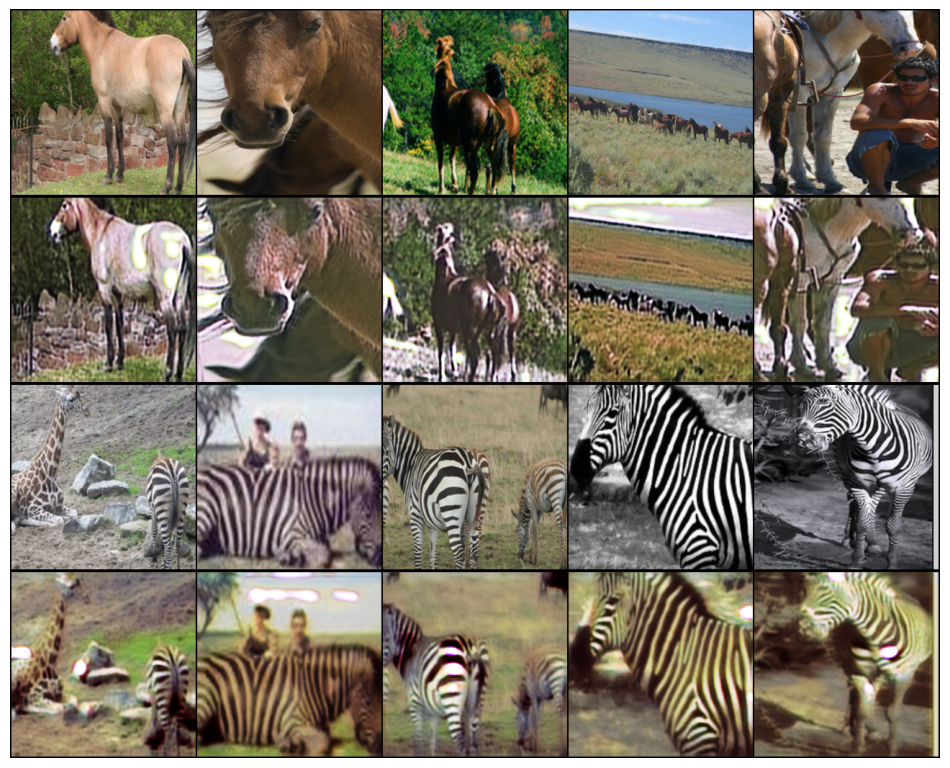

EPOCH: 1.000  loss_D: 0.288  loss_G: 3.977  loss_GAN: 0.438  loss_identity: 0.220  loss_cycle: 0.244  (210.63s - 4001.90s remaining)
EPOCH: 2.000  loss_D: 0.242  loss_G: 3.745  loss_GAN: 0.444  loss_cycle: 0.215  loss_identity: 0.230  (422.05s - 3798.43s remaining)

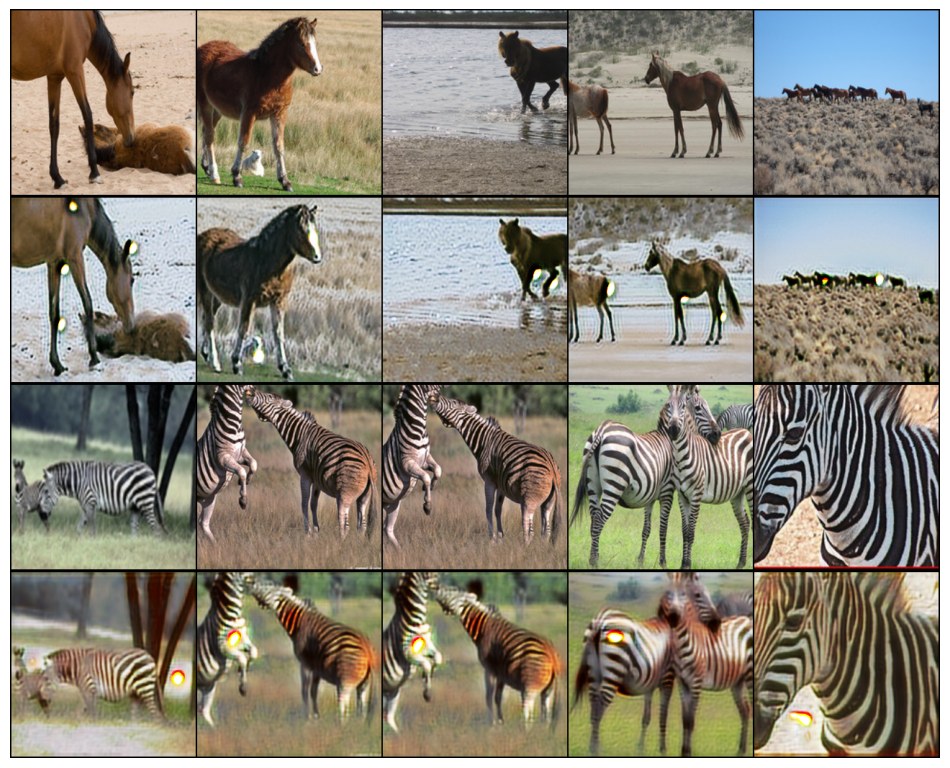

EPOCH: 2.000  loss_D: 0.216  loss_G: 3.538  loss_GAN: 0.506  loss_identity: 0.189  loss_cycle: 0.209  (422.60s - 3803.40s remaining)
EPOCH: 3.000  loss_D: 0.184  loss_G: 2.678  loss_GAN: 0.481  loss_cycle: 0.151  loss_identity: 0.138  (632.17s - 3582.31s remaining)

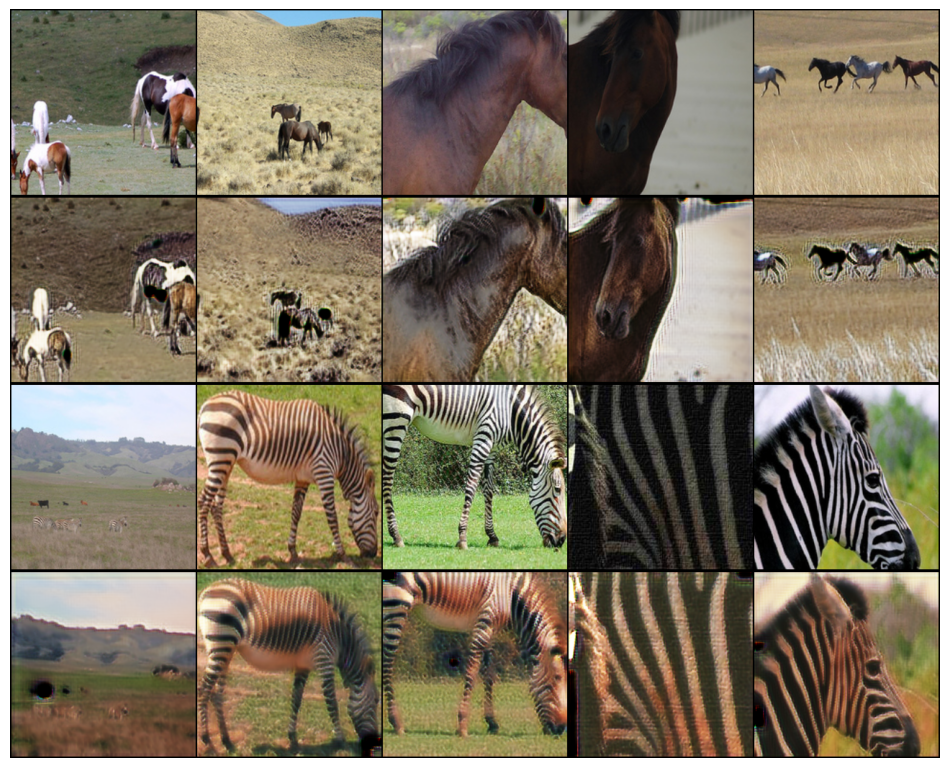

EPOCH: 3.000  loss_D: 0.208  loss_G: 3.410  loss_GAN: 0.516  loss_identity: 0.181  loss_cycle: 0.199  (632.69s - 3585.22s remaining)
EPOCH: 4.000  loss_D: 0.255  loss_G: 2.839  loss_GAN: 0.466  loss_cycle: 0.174  loss_identity: 0.127  (842.71s - 3370.84s remaining)

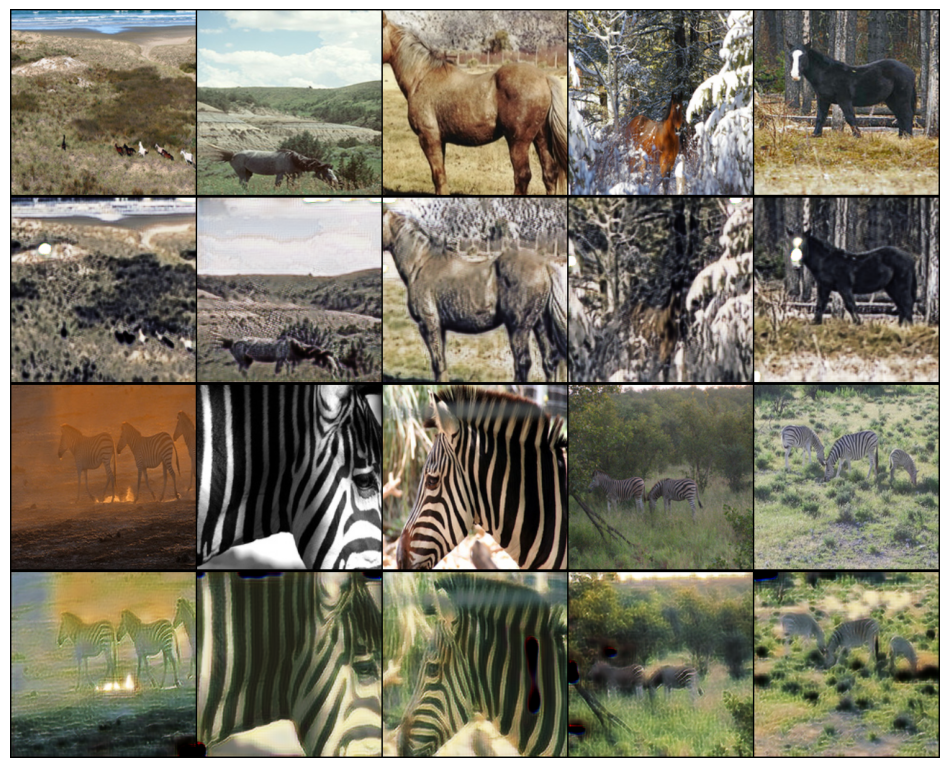

EPOCH: 4.000  loss_D: 0.204  loss_G: 3.315  loss_GAN: 0.517  loss_identity: 0.175  loss_cycle: 0.192  (843.23s - 3372.91s remaining)
EPOCH: 5.000  loss_D: 0.119  loss_G: 2.734  loss_GAN: 0.598  loss_cycle: 0.153  loss_identity: 0.120  (1052.00s - 3155.99s remaining)

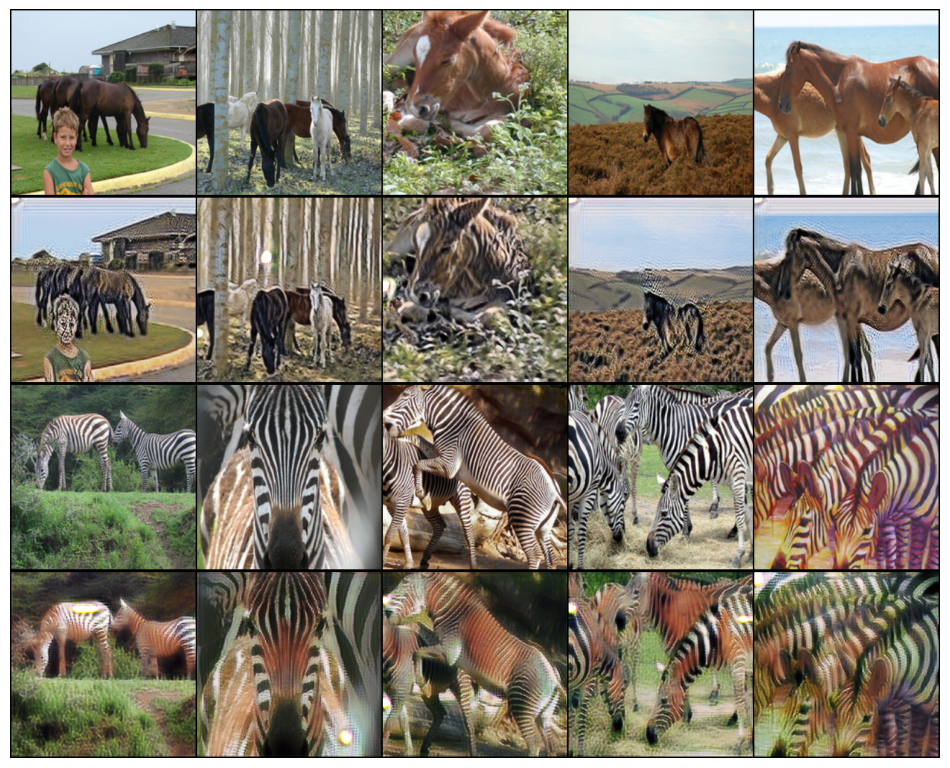

EPOCH: 5.000  loss_D: 0.198  loss_G: 3.183  loss_GAN: 0.527  loss_identity: 0.166  loss_cycle: 0.183  (1052.48s - 3157.44s remaining)
EPOCH: 6.000  loss_D: 0.182  loss_G: 3.016  loss_GAN: 0.484  loss_cycle: 0.175  loss_identity: 0.156  (1261.75s - 2944.08s remaining)

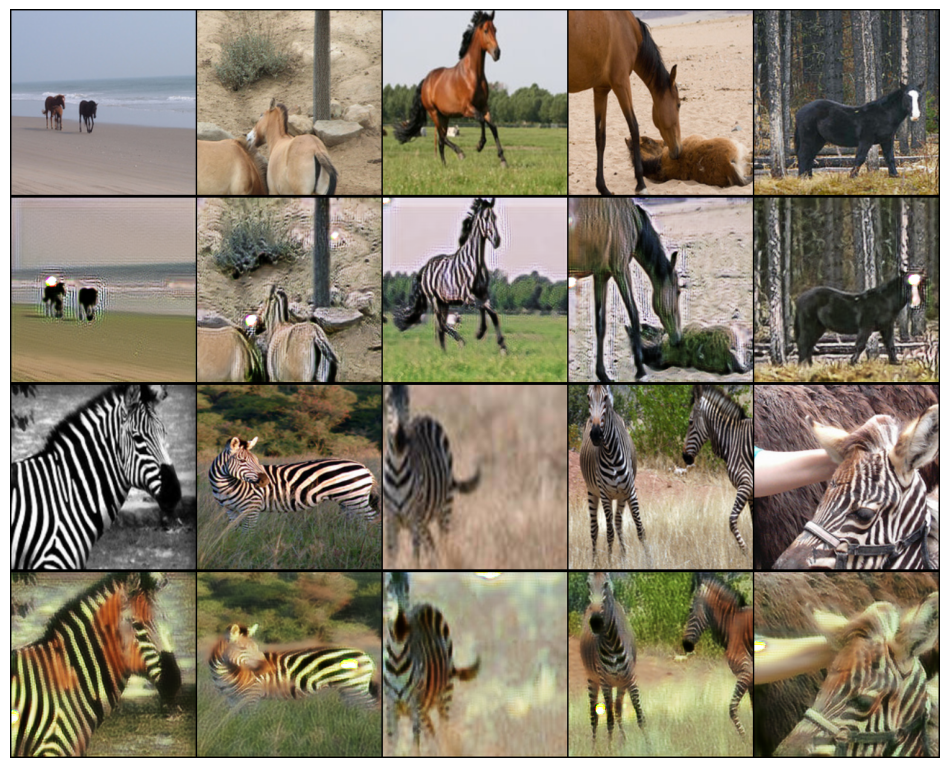

EPOCH: 6.000  loss_D: 0.191  loss_G: 3.080  loss_GAN: 0.550  loss_identity: 0.159  loss_cycle: 0.173  (1262.24s - 2945.22s remaining)
EPOCH: 7.000  loss_D: 0.057  loss_G: 3.230  loss_GAN: 0.681  loss_cycle: 0.174  loss_identity: 0.161  (1470.50s - 2730.94s remaining)

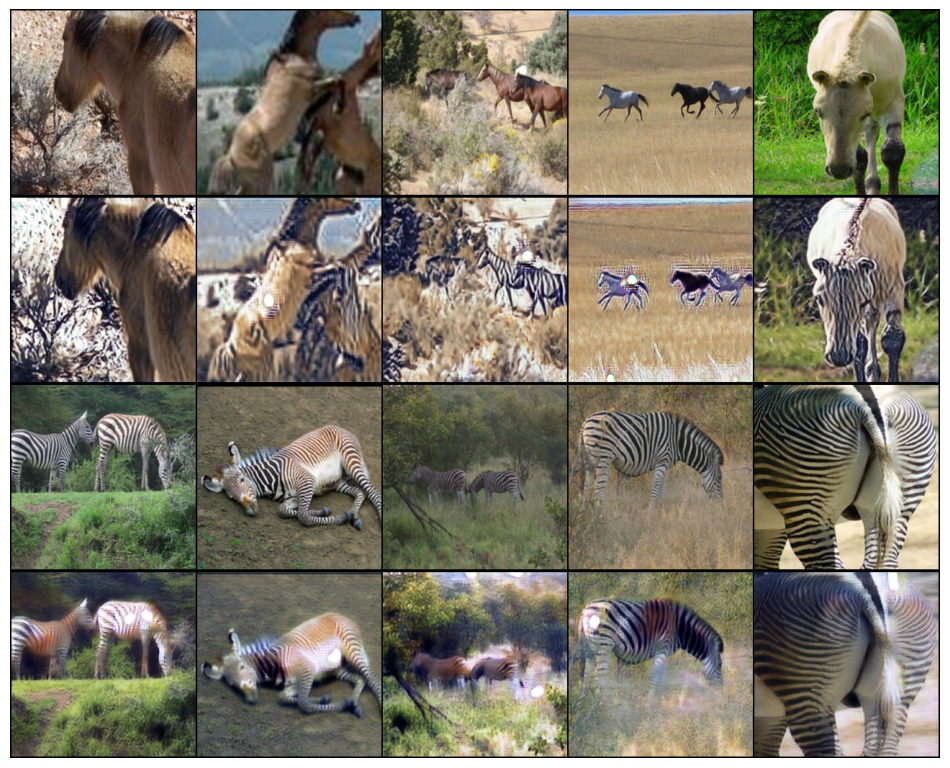

EPOCH: 7.000  loss_D: 0.178  loss_G: 3.109  loss_GAN: 0.569  loss_identity: 0.160  loss_cycle: 0.174  (1471.04s - 2731.94s remaining)
EPOCH: 8.000  loss_D: 0.251  loss_G: 2.712  loss_GAN: 0.583  loss_cycle: 0.140  loss_identity: 0.146  (1680.61s - 2520.91s remaining)

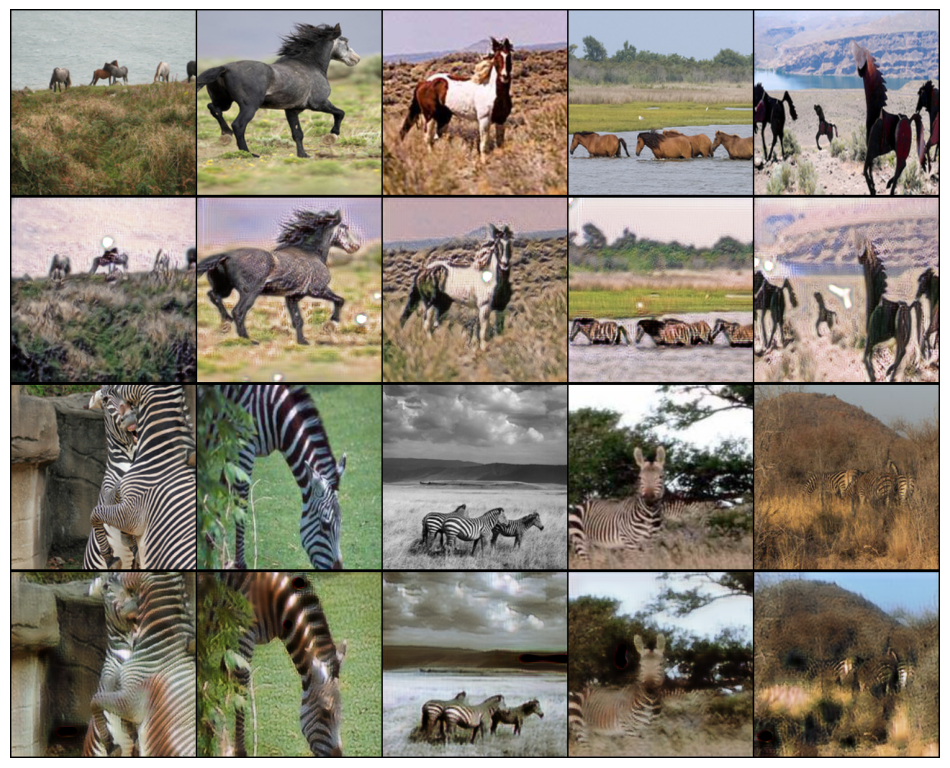

EPOCH: 8.000  loss_D: 0.180  loss_G: 3.069  loss_GAN: 0.569  loss_identity: 0.156  loss_cycle: 0.172  (1681.12s - 2521.68s remaining)
EPOCH: 9.000  loss_D: 0.100  loss_G: 2.974  loss_GAN: 0.603  loss_cycle: 0.163  loss_identity: 0.149  (1890.32s - 2310.39s remaining)

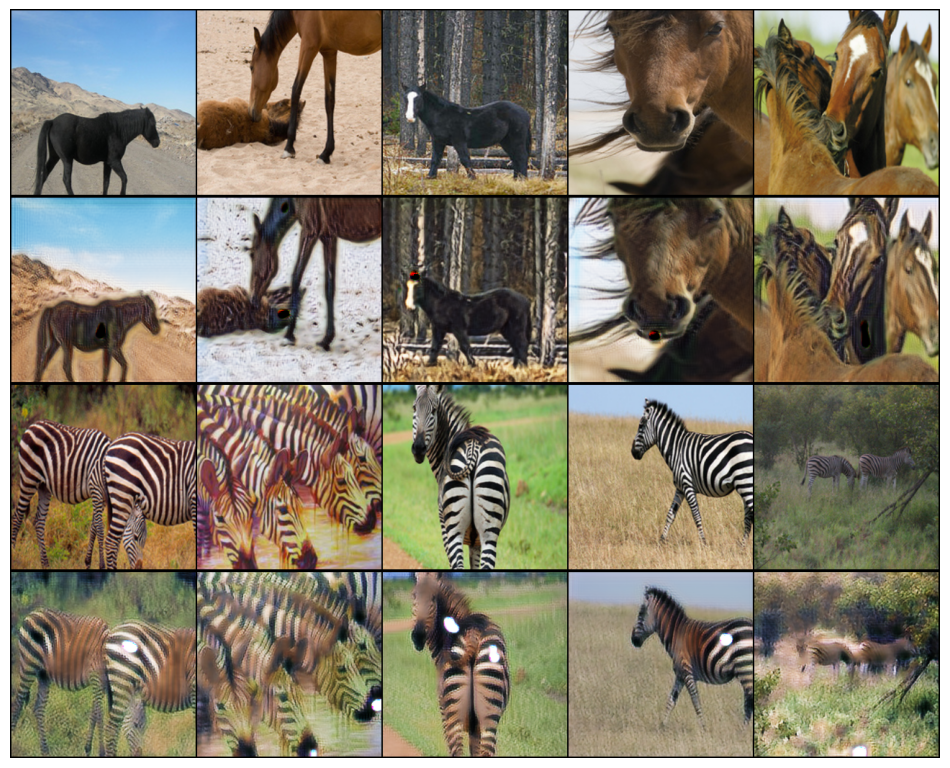

EPOCH: 9.000  loss_D: 0.188  loss_G: 3.006  loss_GAN: 0.536  loss_identity: 0.154  loss_cycle: 0.170  (1890.84s - 2311.02s remaining)
EPOCH: 10.000  loss_D: 0.148  loss_G: 3.660  loss_GAN: 0.540  loss_cycle: 0.215  loss_identity: 0.194  (2101.08s - 2101.08s remaining)

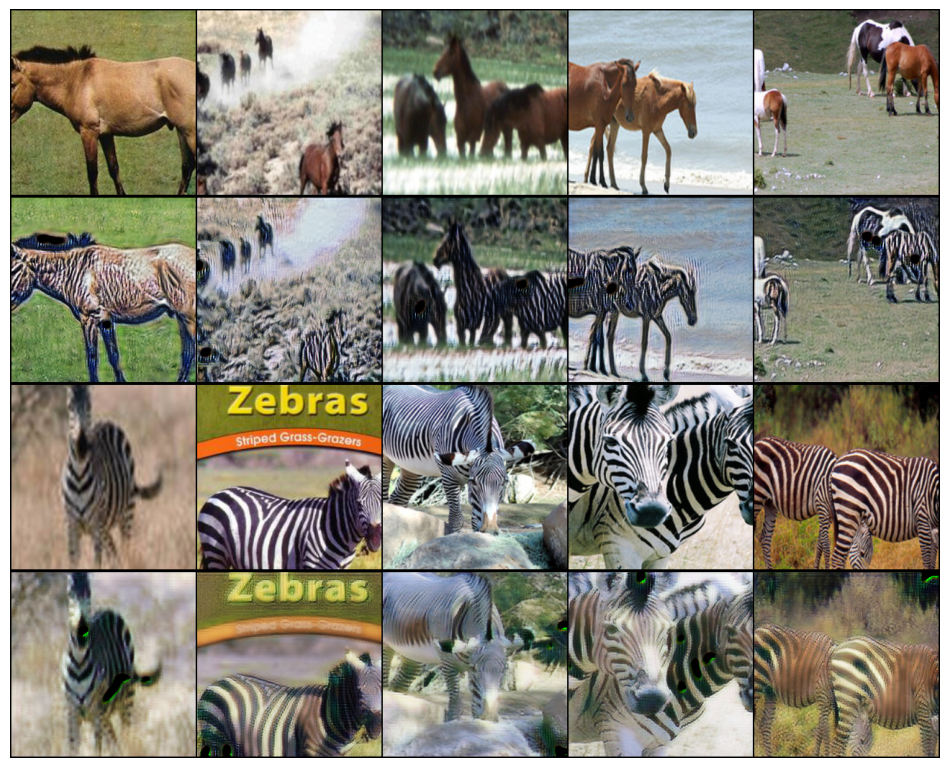

EPOCH: 10.000  loss_D: 0.189  loss_G: 2.958  loss_GAN: 0.537  loss_identity: 0.151  loss_cycle: 0.167  (2101.60s - 2101.60s remaining)
EPOCH: 11.000  loss_D: 0.167  loss_G: 3.249  loss_GAN: 0.676  loss_cycle: 0.172  loss_identity: 0.171  (2311.13s - 1890.93s remaining)

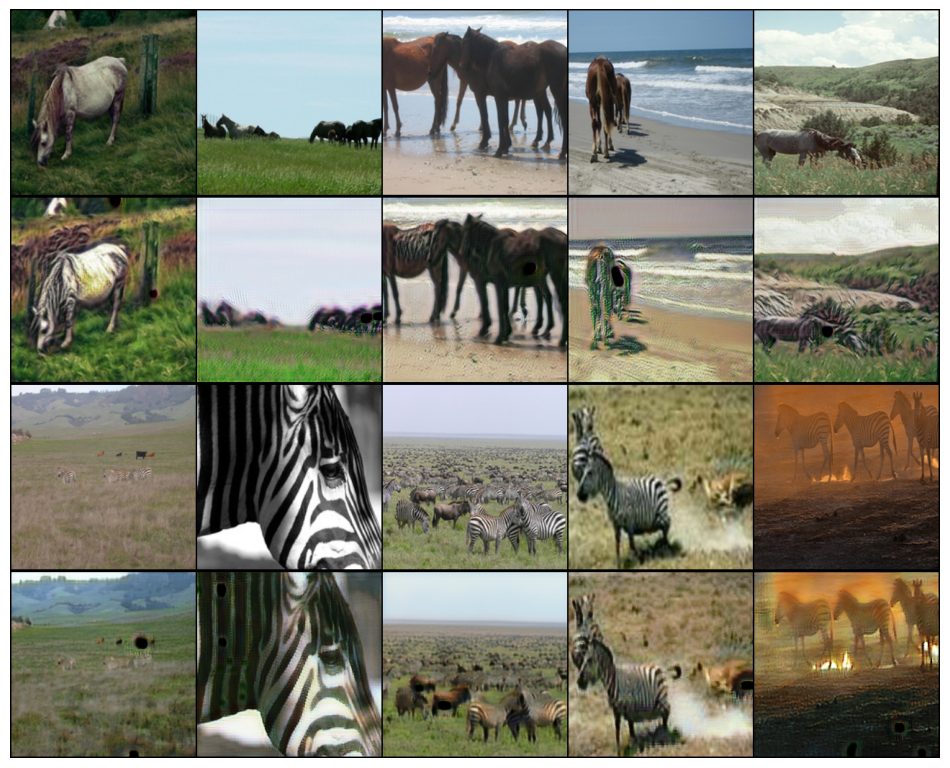

EPOCH: 11.000  loss_D: 0.183  loss_G: 2.927  loss_GAN: 0.546  loss_identity: 0.148  loss_cycle: 0.164  (2311.66s - 1891.36s remaining)
EPOCH: 12.000  loss_D: 0.083  loss_G: 2.407  loss_GAN: 0.509  loss_cycle: 0.125  loss_identity: 0.130  (2521.40s - 1680.93s remaining)

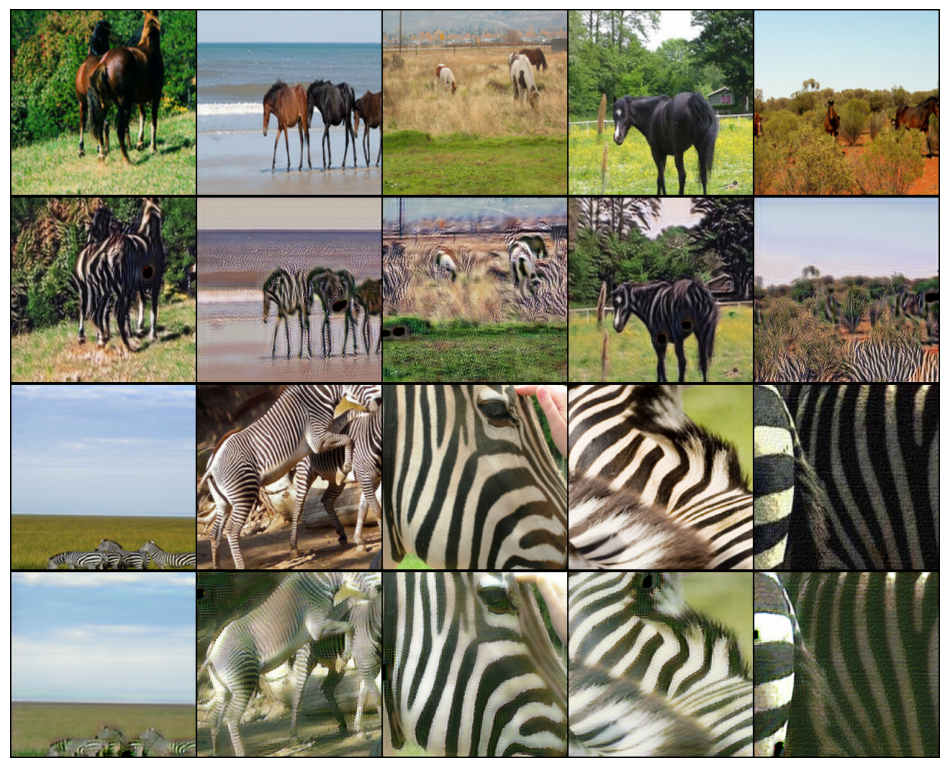

EPOCH: 12.000  loss_D: 0.177  loss_G: 2.868  loss_GAN: 0.559  loss_identity: 0.143  loss_cycle: 0.159  (2521.90s - 1681.27s remaining)
EPOCH: 13.000  loss_D: 0.085  loss_G: 3.959  loss_GAN: 0.680  loss_cycle: 0.234  loss_identity: 0.187  (2729.73s - 1469.86s remaining)

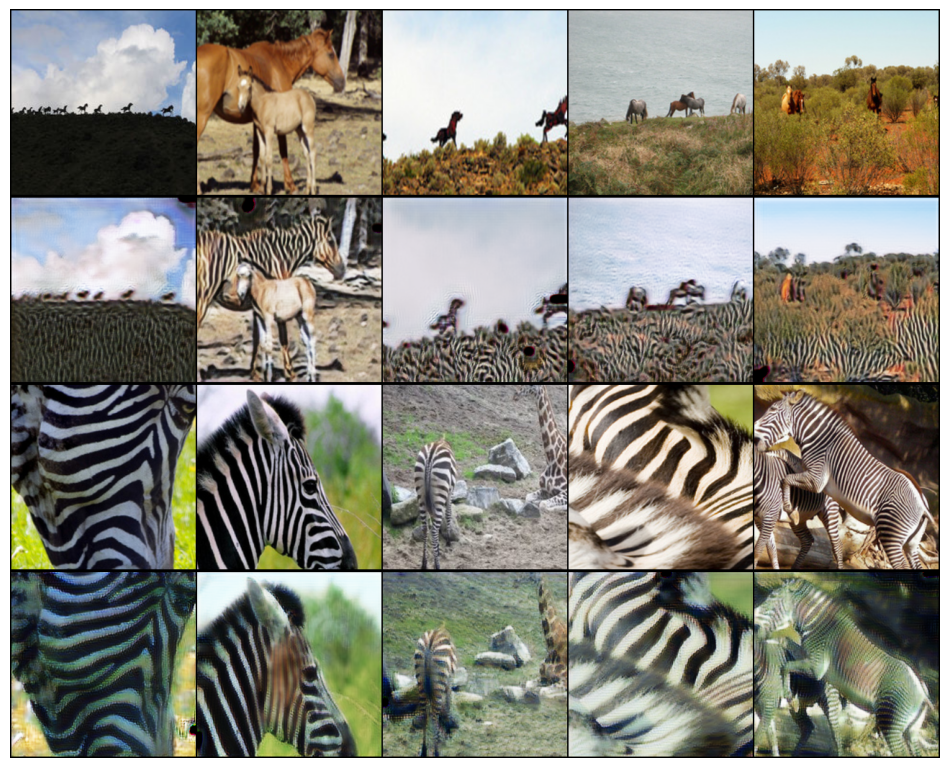

EPOCH: 13.000  loss_D: 0.170  loss_G: 2.879  loss_GAN: 0.578  loss_identity: 0.142  loss_cycle: 0.159  (2730.24s - 1470.13s remaining)
EPOCH: 14.000  loss_D: 0.055  loss_G: 3.456  loss_GAN: 0.895  loss_cycle: 0.176  loss_identity: 0.160  (2941.50s - 1260.64s remaining)

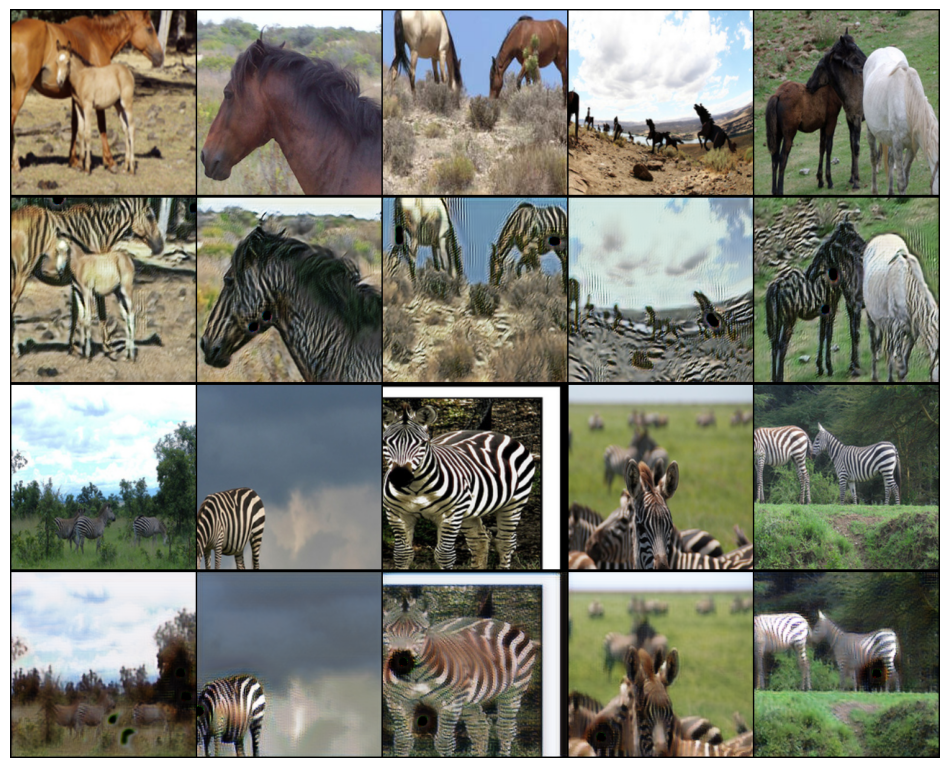

EPOCH: 14.000  loss_D: 0.161  loss_G: 2.906  loss_GAN: 0.602  loss_identity: 0.143  loss_cycle: 0.159  (2942.04s - 1260.87s remaining)
EPOCH: 15.000  loss_D: 0.330  loss_G: 2.193  loss_GAN: 0.584  loss_cycle: 0.108  loss_identity: 0.107  (3150.79s - 1050.26s remaining)

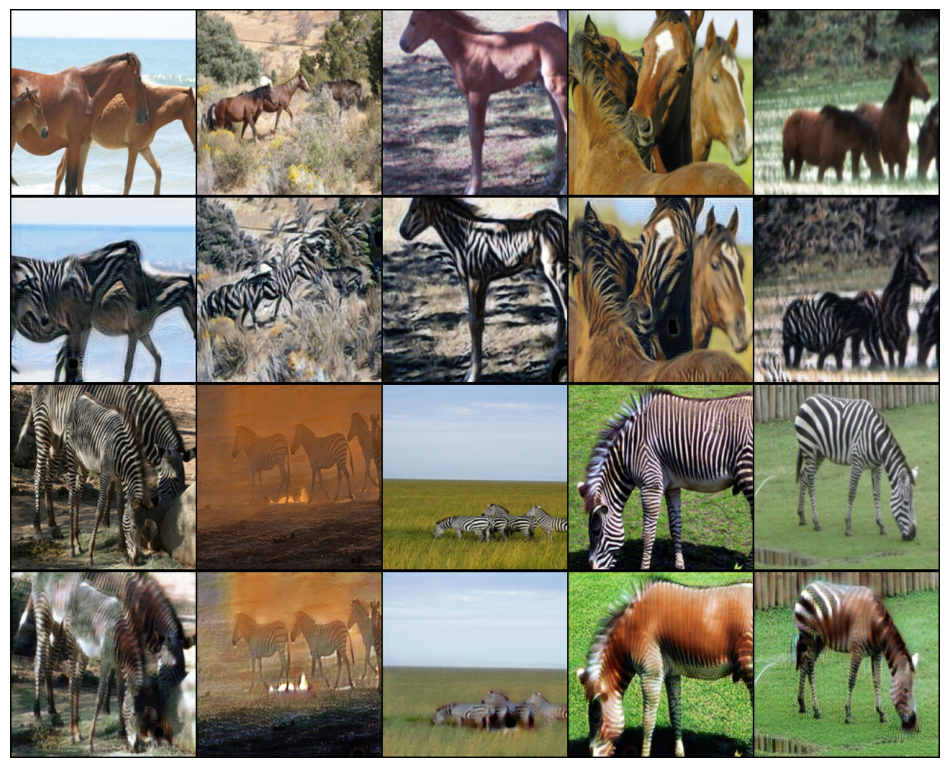

EPOCH: 15.000  loss_D: 0.156  loss_G: 2.827  loss_GAN: 0.615  loss_identity: 0.137  loss_cycle: 0.153  (3151.32s - 1050.44s remaining)
EPOCH: 16.000  loss_D: 0.075  loss_G: 3.396  loss_GAN: 0.880  loss_cycle: 0.171  loss_identity: 0.160  (3359.99s - 840.00s remaining))

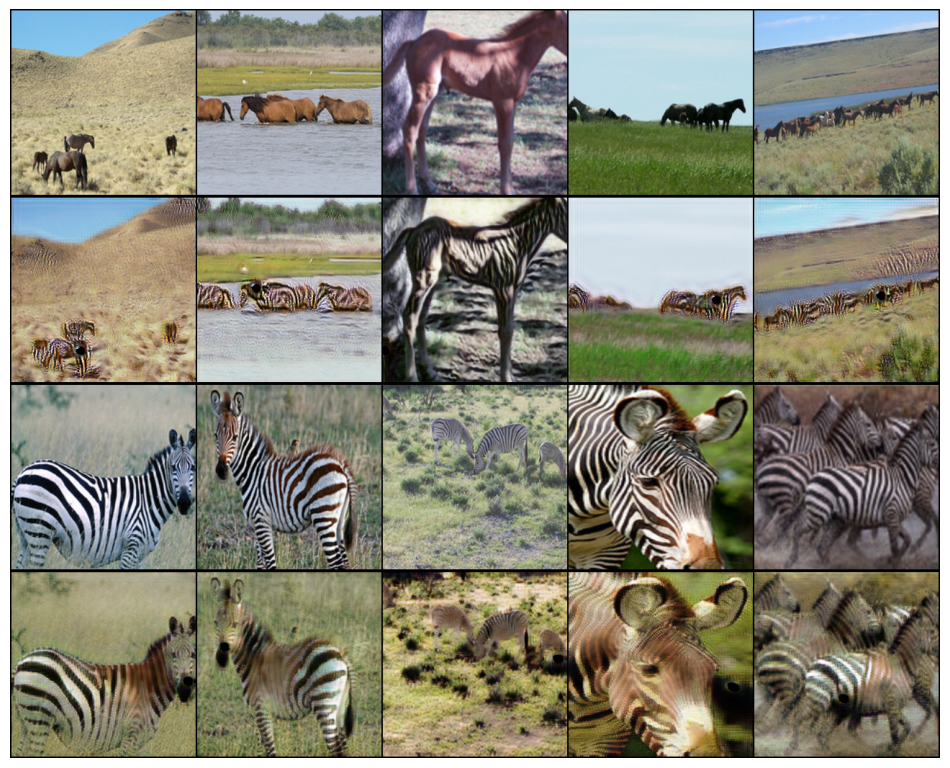

EPOCH: 16.000  loss_D: 0.154  loss_G: 2.815  loss_GAN: 0.614  loss_identity: 0.136  loss_cycle: 0.152  (3360.51s - 840.13s remaining)
EPOCH: 17.000  loss_D: 0.039  loss_G: 2.961  loss_GAN: 0.867  loss_cycle: 0.151  loss_identity: 0.116  (3569.28s - 629.87s remaining)

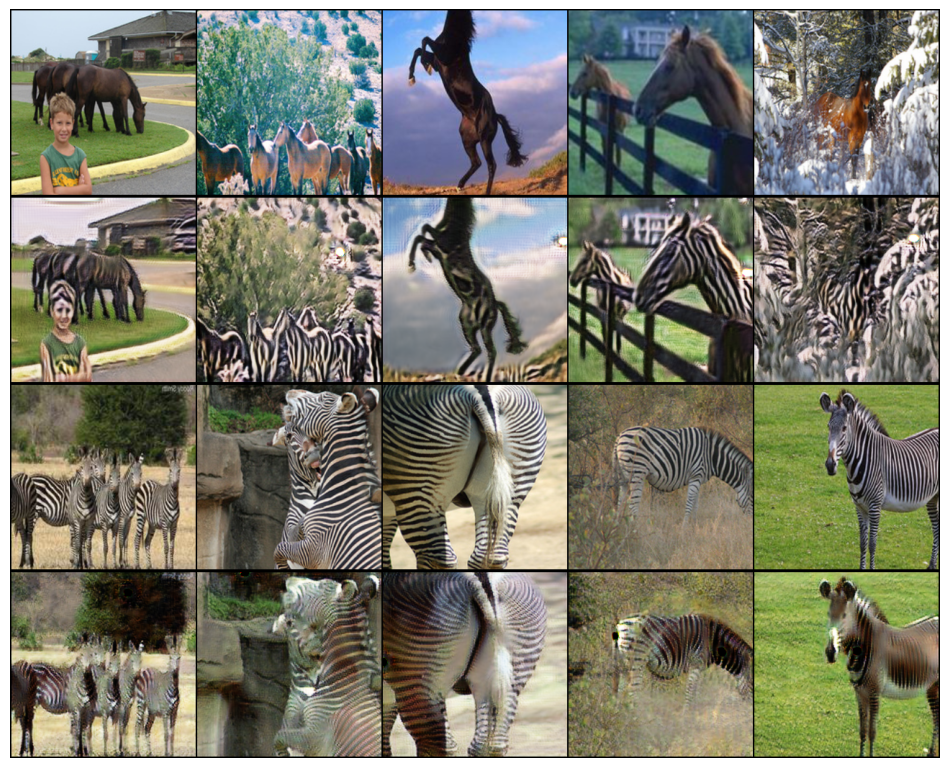

EPOCH: 17.000  loss_D: 0.147  loss_G: 2.873  loss_GAN: 0.633  loss_identity: 0.136  loss_cycle: 0.156  (3569.81s - 629.97s remaining)
EPOCH: 18.000  loss_D: 0.139  loss_G: 2.192  loss_GAN: 0.350  loss_cycle: 0.133  loss_identity: 0.103  (3781.47s - 420.16s remaining)

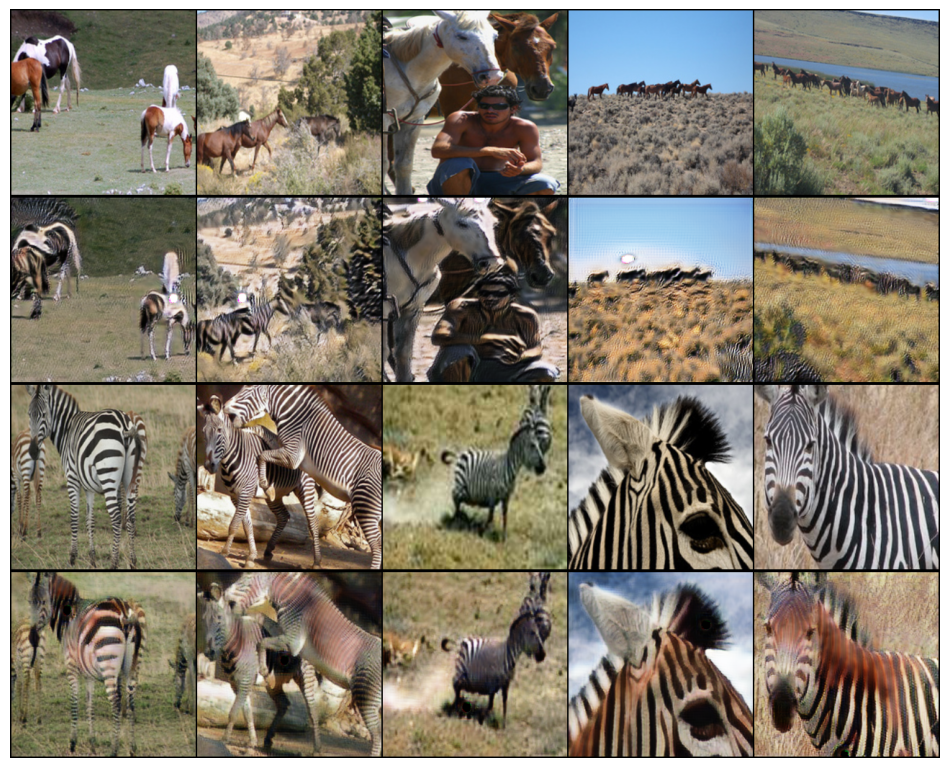

EPOCH: 18.000  loss_D: 0.154  loss_G: 2.816  loss_GAN: 0.615  loss_identity: 0.134  loss_cycle: 0.153  (3782.01s - 420.22s remaining)
EPOCH: 19.000  loss_D: 0.071  loss_G: 3.278  loss_GAN: 0.641  loss_cycle: 0.177  loss_identity: 0.173  (3992.95s - 210.16s remaining)

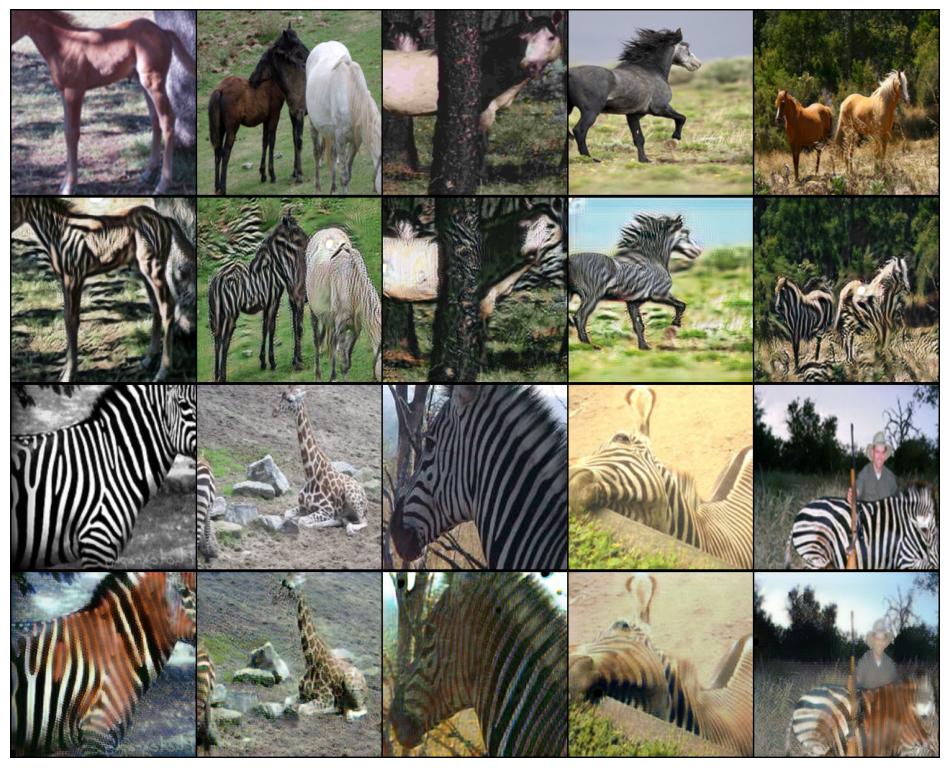

EPOCH: 19.000  loss_D: 0.145  loss_G: 2.832  loss_GAN: 0.635  loss_identity: 0.134  loss_cycle: 0.153  (3993.49s - 210.18s remaining)
EPOCH: 20.000  loss_D: 0.109  loss_G: 1.937  loss_GAN: 0.502  loss_cycle: 0.095  loss_identity: 0.096  (4204.10s - 0.00s remaining)))

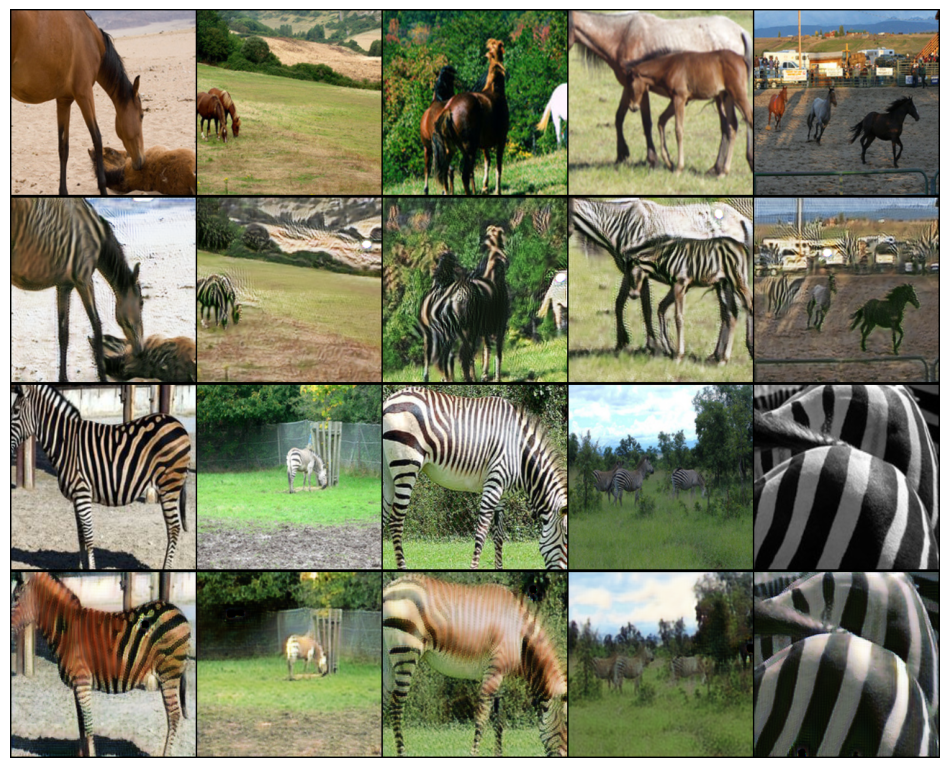

EPOCH: 20.000  loss_D: 0.145  loss_G: 2.811  loss_GAN: 0.632  loss_identity: 0.133  loss_cycle: 0.151  (4204.64s - 0.00s remaining)


In [14]:
n_epochs = 20
log = Report(n_epochs)
for epoch in range(n_epochs):
    N = len(trn_dl)
    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB,G_BA), optimizer_G, real_A, real_B)
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2

        log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(),
                   loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(),
                   loss_identity=loss_identity.item(), end='\r')
    generate_sample()

    log.report_avgs(epoch+1)

100%|██████████| 121/121 [00:01<00:00, 92.22it/s] 


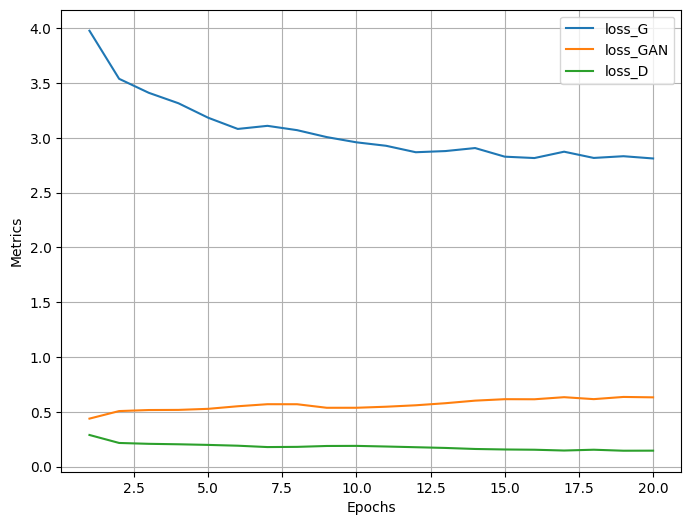

In [15]:
log.plot_epochs(['loss_G','loss_GAN', 'loss_D'])